[-2.440990239233697, -2.899109082633032, -5.678698976257275]
Acceleration: [0.5313744  0.73363114 0.42358777] 
Velocity: [0.07970616 0.11004467 0.06353817] 
Position: [-2.44099024 -2.89910908 -5.67869898]
Acceleration: [0.51927273 0.84828325 0.10378519] 
Velocity: [0.15759707 0.23728716 0.07910594] 
Position: [-2.42903432 -2.88260238 -5.66916825]
Acceleration: [0.50985046 0.84606084 0.15567133] 
Velocity: [0.23407464 0.36419628 0.10245664] 
Position: [-2.40539476 -2.84700931 -5.65730236]
Acceleration: [0.62982645 0.61376528 0.47603658] 
Velocity: [0.32854861 0.45626108 0.17386213] 
Position: [-2.37028356 -2.79237987 -5.64193386]
Acceleration: [0.38847034 0.8674473  0.3108472 ] 
Velocity: [0.38681916 0.58637817 0.22048921] 
Position: [-2.32100127 -2.7239407  -5.61585454]
Acceleration: [0.05746535 0.52013072 0.85215126] 
Velocity: [0.39543896 0.66439778 0.3483119 ] 
Position: [-2.26297839 -2.63598398 -5.58278116]
Acceleration: [-0.21471967  0.65518942  0.72430815] 
Velocity: [0.36323101 

Animation size has reached 21007029 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


Acceleration: [-0.55027817 -0.82641624 -0.11929017] 
Velocity: [ 0.40014865  0.52089371 -0.4787395 ] 
Position: [-2.50665251  6.2244531  -1.88371666]
Acceleration: [-0.21852786 -0.46776716  0.8564108 ] 
Velocity: [ 0.36736947  0.45072863 -0.35027788] 
Position: [-2.44663021  6.30258716 -1.95552759]
Acceleration: [-0.35270715 -0.82450081 -0.44248851] 
Velocity: [ 0.3144634   0.32705351 -0.41665116] 
Position: [-2.39152479  6.37019645 -2.00806927]
Acceleration: [ 0.45829841 -0.85092218  0.2566983 ] 
Velocity: [ 0.38320816  0.19941519 -0.37814641] 
Position: [-2.34435529  6.41925448 -2.07056694]
Acceleration: [-0.22701121 -0.96590281  0.12448966] 
Velocity: [ 0.34915647  0.05452976 -0.35947296] 
Position: [-2.28687406  6.44916676 -2.1272889 ]
Acceleration: [ 0.53656164 -0.83932018  0.08742565] 
Velocity: [ 0.42964072 -0.07136826 -0.34635911] 
Position: [-2.23450059  6.45734622 -2.18120985]
Acceleration: [-0.63224982  0.71253274 -0.30423225] 
Velocity: [ 0.33480325  0.03551165 -0.39199395]

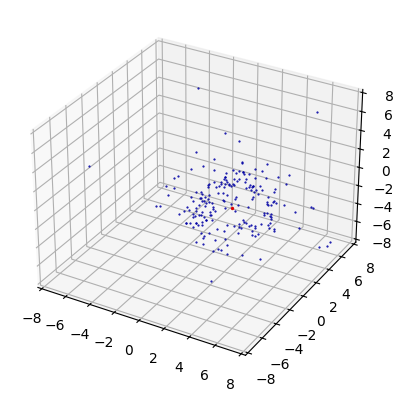

In [2]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-
"""Addition of a predator to the flock:
-> So what if there was an evil shep added into the flock
-> The evil shep acts in a pretty similar way to the others
but it chases them down. as such, there is no seperation acceleration
for the evil shep. the regular sheep have been updated to avoid the predator at as a priority"""

import numpy as np
import matplotlib.pyplot as plt
from dataclasses import dataclass
from IPython.display import HTML
from matplotlib.animation import FuncAnimation

rng = np.random.default_rng(seed=12)


@dataclass
class Sheep:
    N: int
    X: float
    V: float

    def flock(self):
        temp = []
        for _ in range(self.N):
            x = self.X * rng.normal(size=3)
            v = self.V * rng.normal(size=3)
            temp.append(Shep(x, v))
        return np.array(temp)


@dataclass
class Shep:

    x: list[float]
    v: list[float]

    def update_acceleration(self, herd, c_alg, c_coh, c_sep, c_const, c_bound, c_rand, c_pred, theta, wind):

        a_align = np.zeros(3)
        a_cohesion = np.zeros(3)
        a_sep = np.zeros(3)
        a_const = np.zeros(3)
        a_rand = c_rand * rng.normal(size=3)
        a_predator = np.zeros(3)

        for shep in herd:
            if shep is self:
                continue
            r = shep.x - self.x
            vr = shep.v - self.v
            rmag_sq = r.dot(r)
            '''a_wind = np.zeros(3)
            wind_dist = self.x-wind_centre
            wind_dist_mag_sq = wind_dist.dot(wind_dist)
            '''

            if rmag_sq > 25 or r.dot(vr) < theta:
                continue
            '''a_wind = [wind*self.x[1]/(np.sqrt(self.x[0]**2+self.x[1]**2)*wind_dist_mag_sq)+wind_centre[0],wind*self.x[0]/(np.sqrt(self.x[0]**2+self.x[1]**2)*wind_dist_mag_sq)+wind_centre[1],wind*0]'''
            a_align += c_alg * vr
            a_cohesion += c_coh * r
            a_const += c_const*self.v/np.sqrt(self.v.dot(self.v))

            if rmag_sq < 4:
                a_sep -= c_sep * r / rmag_sq
                
        r_evil = predator.x - self.x
        rmag_sq_evil = r_evil.dot(r_evil)
        
        '''for a small radius around them, the sheps can just "detect"
        the predator regardless of whether they're looking at it or not'''
        if rmag_sq_evil < 10:
            a_predator -= c_pred*r_evil/rmag_sq_evil
        a_total = a_align + a_cohesion + a_sep + a_const + a_rand + a_predator # a_wind
        a_total += (np.abs(self.x) > boundary) * -np.sign(self.x) * c_bound
        self.a = a_total
        # normalisation of the acceleration vector
        try:
            self.a = a_total * (1 / float(np.sqrt(a_total.dot(a_total))))
        except:
            self.a = np.zeros(3)

    def dynamics(self, dt):
        self.v += self.a * dt

        # some code to set a maximum speed.
        # this requires tweaking to the parameters to work properly.
        # currently, the forces are too high for this to work

        '''if np.abs(np.sqrt(self.v.dot(self.v))) > np.abs(max_vel):
            self.v = self.v*(max_vel/np.sqrt(self.v.dot(self.v)))
        '''

        self.x += self.v * dt

"""here is our evil shep in question. I'm using an init function
for this one. this is not done with any particular reason in mind"""
@dataclass
class EvilShep:

    def __init__(self, x, v, a_total, evil_c_pos, evil_c_dir, evil_c_rand):
        self.x = [np.random.uniform(-6,6),np.random.uniform(-6,6),np.random.uniform(-6,6)]
        self.v = np.zeros(3)
        self.a_total = np.zeros(3)
        self.evil_c_pos = evil_c_pos
        self.evil_c_dir = evil_c_dir
        self.evil_c_rand = evil_c_rand

    def evil_acceleration(self):
        a_pos = np.zeros(3)
        a_dir = np.zeros(3)
        a_rand = evil_c_rand * rng.normal(size=3)
        for shep in herd:
            evil_r = shep.x - self.x
            evil_vel_r = shep.v - self.v
            evil_r_mag = np.sqrt(evil_r.dot(evil_r))
            if evil_r_mag > 4 or evil_r.dot(evil_vel_r) < theta:
                continue
            a_pos += evil_c_pos * evil_r
            a_dir += evil_c_dir * evil_vel_r

            a_total = a_pos + a_dir
            a_total += 1.5*(np.abs(self.x) > boundary) * -np.sign(self.x) * c_bound
            try:
                self.a_total = a_total * (1 / float(np.sqrt(a_total.dot(a_total))))
            except:
                self.a_total = np.zeros(3)

    def evil_dynamics(self):
        self.x += self.v * dt
        self.v += self.a_total * dt


predator = EvilShep(np.zeros(3), np.zeros(3), np.zeros(3), np.zeros(3), np.zeros(3), np.zeros(3))
print(predator.x)


dt = 0.15
N = 200
X = 3
V = 5*dt
n = 300

c_alg = 1/n
c_coh = 4/n
c_sep = 15/n
c_const = 0.7/n
c_rand = 1/n
c_bound = 500
c_pred = 100
'''wind_centre = [1,1,1]
wind = 2'''
boundary = 6.5
theta = 0
max_vel = 2

evil_c_dir = 2
evil_c_pos = 1
evil_c_rand = 0.5


herd = Sheep(N, X, V).flock()


end_time = 40

fig = plt.figure()
ax = fig.add_subplot(111, projection="3d")


def update(_):
    ax.clear()
    ax.set_xlim(-8, 8)
    ax.set_ylim(-8, 8)
    ax.set_zlim(-8, 8)

    for shep in herd:
        ax.scatter(*shep.x, s=0.3, c='#0000A4')
        shep.update_acceleration(herd, c_alg, c_coh, c_sep, c_const, c_bound, c_rand, c_pred, theta, '''wind''')

    for shep in herd:
        shep.dynamics(dt)
        #print(shep.x)
    ax.scatter(*predator.x, s=2, c='#DD0000')
    predator.evil_acceleration()
    predator.evil_dynamics()
    print("Acceleration:", predator.a_total,
          "\nVelocity:", predator.v,
          "\nPosition:", predator.x)


animation = FuncAnimation(fig, update, frames=int(end_time/dt), interval=80)
#animation.save('sheep_animation_1_3.gif', writer='pillow')

HTML(animation.to_jshtml())
